# Exploratory Data Analysis
This notebook perform main exploratory codeforces data analysis. It introduces functions for data parsing and represent exploratory data analysis (EDA).

As soon as the data parsing from the codeforces is a very durable process (due to codeforces restrictions), the main data analysis is based on the already collected sample of data in json files.

The notebook consits of 3 main parts:
1. Prerequizites: library installation and import, data models definitions;
2. Data Parsing;
3. Exploratory Data Analysis:
   - Problem Topics Analysis;
   - User Performance Anslysis;
   - Blogs Analysis.

## Prerequizites: library installation and import, data models definition.

First, let's install and import all the necessary libraries

In [ ]:
!pip install requests
!pip install pandas
!pip install numpy
!pip install seaborn
!pip install matplotlib
!pip install bertopic

In [1]:
from bertopic.representation import KeyBERTInspired
from bertopic import BERTopic
import matplotlib.pyplot as plt
from typing import List
import seaborn as sns
import pandas as pd
import numpy as np
import requests
import random
import json
import time

c:\Users\fatkh\AppData\Local\Programs\Python\Python311\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Second, let's define data models that will be utilized for convenient data analysis

In [2]:
class User:
    def __init__(self, handle: str, registrationTimeSeconds: int):
        self.handle = handle
        self.registrationTimeSeconds = registrationTimeSeconds

    def __repr__(self):
        return f"User(handle={self.handle!r}, registrationTimeSeconds={self.registrationTimeSeconds!r})"
    
    def to_dict(self):
        return {
            'handle': self.handle,
            'registrationTimeSeconds': self.registrationTimeSeconds
        }


class Contest:
    def __init__(self, id: int, startTimeSeconds: int):
        self.id = id
        self.startTimeSeconds = startTimeSeconds

    def __repr__(self):
        return f"Contest(id={self.id!r}, startTimeSeconds={self.startTimeSeconds!r})"
    
    def to_dict(self):
        return {
            'id': self.id,
            'startTimeSeconds': self.startTimeSeconds
        }


class Problem:
    def __init__(self, contest_id: int, index: str, rating: int, success_trials: int, unsuccess_trials: int):
        self.contest_id = contest_id
        self.index = index
        self.rating = rating
        self.success_trials = success_trials
        self.unsuccess_trials = unsuccess_trials

    def __repr__(self):
        return (f"Problem(contest_id={self.contest_id!r}, index={self.index!r}, rating={self.rating!r}, "
                f"success_trials={self.success_trials!r}, unsuccess_trials={self.unsuccess_trials!r})")
    
    def to_dict(self):
        return {
            'contest_id': self.contest_id,
            'index': self.index,
            'rating': self.rating,
            'success_trials': self.success_trials,
            'unsuccess_trials': self.unsuccess_trials
        }


class Blog:
    def __init__(self, id: int, title: str, rating: int, numberOfComments: int = 0):
        self.id = id
        self.title = title
        self.rating = rating
        self.numberOfComments = numberOfComments

    def __repr__(self):
        return f"Blog(id={self.id!r}, title={self.title!r}, rating={self.rating!r}, numberOfComments={self.numberOfComments!r})"
    
    def to_dict(self):
        return {
            'id': self.id,
            'title': self.title,
            'rating': self.rating,
            'numberOfComments': self.numberOfComments
        }


class Participation:
    def __init__(self, user_handle: str, contest_id: int, rank: int, new_rating: int, rating_change: int):
        self.user_handle = user_handle
        self.contest_id = contest_id
        self.rank = rank
        self.new_rating = new_rating
        self.rating_change = rating_change

    def __repr__(self):
        return (f"Participation(user_handle={self.user_handle!r}, contest_id={self.contest_id!r}, rank={self.rank!r}, "
                f"new_rating={self.new_rating!r}, rating_change={self.rating_change!r})")
    
    def to_dict(self):
        return {
            'user_handle': self.user_handle,
            'contest_id': self.contest_id,
            'rank': self.rank,
            'new_rating': self.new_rating,
            'rating_change': self.rating_change
        }


class Solution:
    def __init__(self, user_handle: str, problem_contest_id: int, problem_index: str, timeSeconds: int):
        self.user_handle = user_handle
        self.problem_contest_id = problem_contest_id
        self.problem_index = problem_index
        self.timeSeconds = timeSeconds

    def __repr__(self):
        return (f"Solution(user_handle={self.user_handle!r}, contest_id={self.problem_contest_id!r}, "
                f"problem_index={self.problem_index}, timeSeconds={self.timeSeconds!r})")
    
    def to_dict(self):
        return {
            'user_handle': self.user_handle,
            'problem_contest_id': self.problem_contest_id,
            'problem_index': self.problem_index,
            'timeSeconds': self.timeSeconds
        }


class ProblemTag:
    def __init__(self, problem_contest_id: int, problem_index: str, tag: str):
        self.problem_contest_id = problem_contest_id
        self.problem_index = problem_index
        self.tag = tag

    def __repr__(self):
        return f"ProblemTag(contest_id={self.problem_contest_id!r}, problem_index={self.problem_index}, tag={self.tag!r})"
    
    def to_dict(self):
        return {
            'problem_contest_id': self.problem_contest_id,
            'problem_index': self.problem_index,
            'tag': self.tag
        }


class BlogTag:
    def __init__(self, blog_id: int, tag: str):
        self.blog_id = blog_id
        self.tag = tag

    def __repr__(self):
        return f"BlogTag(blog_id={self.blog_id!r}, tag={self.tag!r})"
    
    def to_dict(self):
        return {
            'blog_id': self.blog_id,
            'tag': self.tag
        }

## Data Parsing

Let's define the functions for parsing all the necessary data from the Codeforces.

These functions will encapsulate possible inconsistencies in parsed data.

In [3]:
def parse_contests(lowerRelativeTimeSeconds: int, lowerStartTimeSeconds: int) -> List[Contest]:
    response = requests.get("https://codeforces.com/api/contest.list").json()

    if response['status'] == 'FAILED':
        print(f"{response['status']}.")
        return []

    contests_json = response['result']
    contests_db = []

    for contest in contests_json:
        if contest['relativeTimeSeconds'] >= lowerRelativeTimeSeconds and \
            contest['startTimeSeconds'] >= lowerStartTimeSeconds:
            contests_db.append(Contest(id=contest['id'], startTimeSeconds=contest['startTimeSeconds']))

    return contests_db


def parse_problems(contests: List[Contest]) -> List[Problem]:
    problems_db = []

    for contest in contests:
        params = {"contestId": contest.id, "from": 1, "count": 1000000}
        response = requests.get("https://codeforces.com/api/contest.standings", params=params).json()

        if response['status'] == 'FAILED':
            print(f"{response['comment']}. Problems from the contest are ignored!")
            continue

        problems_json = response['result']['problems']
        standing_json = response['result']['rows']

        for problem_idx, problem in enumerate(problems_json):

            if 'rating' not in problem.keys():
                print(f"Problem {contest.id}-{problem['index']} has not rating. This problem is ignored!")
                continue

            number_of_trials = number_of_success_trials = 0

            for result in standing_json:
                problem_result = result['problemResults'][problem_idx]
                number_of_trials += 1 if (problem_result['points']>0 or problem_result['rejectedAttemptCount']>0) else 0
                number_of_success_trials += 1 if (problem_result['points']>0) else 0

            problems_db.append(
                Problem(contest_id=contest.id, index=problem['index'], rating=problem['rating'],
                    success_trials=number_of_success_trials, unsuccess_trials=number_of_trials-number_of_success_trials)
            )

    return problems_db


def parse_user_info(user_handles: List[str]) -> List[User]:
    users = []

    for handle in user_handles:
        params = {"handles": handle}
        response = requests.get("https://codeforces.com/api/user.info", params=params).json()

        if response['status'] == 'FAILED':
            print(f"{response['comment']}. User {handle} is ignored!")

        user_json = response['result'][0]
        users.append(User(handle=user_json['handle'], registrationTimeSeconds=user_json['registrationTimeSeconds']))

    return users


def parse_user_solutions(user: User, upperSubmissionTimeSeconds: int = 1) -> List[Solution]:
    solved_problems = set()
    solutions = []
    params = {"handle": user.handle}

    response = requests.get("https://codeforces.com/api/user.status", params=params)

    if not response:
        print(f"Failed to get response [function - parse_user_solutions, user - {user}]")
        return []

    response = response.json()

    if response['status'] == 'FAILED':
        print(f"{response['comment']}. The solutions from the user are ignored!")
        return []
    
    submissions = response['result']
    submissions = [submission for submission in submissions if submission['creationTimeSeconds'] < upperSubmissionTimeSeconds]
    submissions = [submission for submission in submissions if submission['verdict'] in ['OK', 'ACCEPTED']]
    submissions.sort(key=lambda x: x['creationTimeSeconds'])

    for submission in submissions:
        problem = submission['problem']

        if ('contestId' not in problem.keys()) or ('index' not in problem.keys()):
            print("Problem does not have contestId or index. The problem is ignored!")
            continue

        problem_id = (problem['contestId'], problem['index'])

        if problem_id not in solved_problems:
            solutions.append(
                Solution(user_handle=user.handle,
                    problem_contest_id=problem['contestId'],
                    problem_index=problem['index'],
                    timeSeconds=submission['creationTimeSeconds'])
                )
            solved_problems.add(problem_id)
    
    return solutions


def parse_blogs_comments(blogs: List[Blog]) -> List[Blog]:
    for blog in blogs:
        response = requests.get(f"https://codeforces.com/api/blogEntry.comments?blogEntryId={blog.id}").json()
        content = response['result']
        blog.numberOfComments = len(content)

    return blogs


def parse_blogs(lowerId: int, upperId: int) -> List[Blog]:
    blogs = []

    for id in range(lowerId, upperId+1):
        response = requests.get(f"https://codeforces.com/api/blogEntry.view?blogEntryId={id}").json()
        if response['status'] != 'FAILED':
            content = response['result']
            blogs.append(Blog(id=id, title=content['title'], rating=content['rating']))

    blogs = parse_blogs_comments(blogs)

    return blogs


def parse_problem_tags(contest_id: int) -> List[ProblemTag]:
    problem_tags = []
    params = {"contestId": contest_id, "from": 1, "count": 1}
    response = requests.get("https://codeforces.com/api/contest.standings", params=params).json()

    if response['status'] == 'FAILED':
        print(f"{response['comment']}. Tags for problems from the contest {contest_id} are not parsed!")
        return []

    problems = response['result']['problems']

    for problem in problems:

        if 'tags' not in problem.keys():
            print(f"Problem {contest_id}-{problem['index']} has not any tag!")
            continue

        for tag in problem['tags']:
            problem_tags.append(ProblemTag(problem_contest_id=contest_id, problem_index=problem['index'], tag=tag))

    return problem_tags


def parse_participations(contest_id: int) -> List[Participation]:
    participations = []
    params = {"contestId": contest_id}
    response = requests.get("https://codeforces.com/api/contest.ratingChanges", params=params).json()

    if response['status'] == 'FAILED':
        print(f"{response['comment']}. Partcipations from the contest {contest_id} are not parsed!")
        return []

    results = response['result']

    if 'rank' not in results[0].keys():
        print(f"Contest {contest_id} does not provide ranks for users. Participations from the contest are not parsed!")
        return []
    
    if ('newRating' not in results[0].keys()) or ('oldRating' not in results[0].keys()):
        print(f"Contest {contest_id} was not rating. Participations from the contest are not parsed!")
        return []

    for result in results:
        ratingChange = int(result['newRating']) - int(result['oldRating'])
        participations.append(
            Participation(user_handle=result['handle'],
                          contest_id=contest_id,
                          rank=result['rank'],
                          new_rating=result['newRating'],
                          rating_change=ratingChange)
        )

    return participations

---
**Contest parsing**

In [7]:
contests = parse_contests(3600 * 24 * 14, 0)
print(f"Number of contests: {len(contests)}")
contest = random.choice(contests)
print(f"Random contest: {contest}")

Number of contests: 1963
Random contest: Contest(id=294, startTimeSeconds=1365348600)


---
**Problems parsing**

In [8]:
problems = parse_problems([contest])
print(*problems, sep='\n')

Problem(contest_id=294, index='A', rating=800, success_trials=1566, unsuccess_trials=60)
Problem(contest_id=294, index='B', rating=1700, success_trials=269, unsuccess_trials=1018)
Problem(contest_id=294, index='C', rating=1900, success_trials=170, unsuccess_trials=89)
Problem(contest_id=294, index='D', rating=2500, success_trials=2, unsuccess_trials=11)
Problem(contest_id=294, index='E', rating=2300, success_trials=5, unsuccess_trials=9)


---
**Participations parsing**

In [9]:
participations = parse_participations(contest.id)
print(f"Number of participants: {len(participations)}")
participant = random.choice(participations)
print(f"Random participant's result: {participant}")

Number of participants: 1684
Random participant's result: Participation(user_handle='alishman.k', contest_id=294, rank=803, new_rating=1315, rating_change=75)


---
**User's information parsing**

In [10]:
user = parse_user_info([participant.user_handle])[0]
user

User(handle='alishman.k', registrationTimeSeconds=1356592477)

---
**User's solutions parsing**

In [11]:
solutions = parse_user_solutions(user, contest.startTimeSeconds)
print(f"Number of solutions: {len(solutions)}")
solution = random.choice(solutions)

print(f"Random solution of the {user.handle}: {solution}")

Number of solutions: 30
Random solution of the alishman.k: Solution(user_handle='alishman.k', contest_id=263, problem_index=A, timeSeconds=1358350485)


---
**Problem tags parsing**

In [12]:
problem_tags = parse_problem_tags(contest.id)
print(*problem_tags, sep='\n')

ProblemTag(contest_id=294, problem_index=A, tag='implementation')
ProblemTag(contest_id=294, problem_index=A, tag='math')
ProblemTag(contest_id=294, problem_index=B, tag='dp')
ProblemTag(contest_id=294, problem_index=B, tag='greedy')
ProblemTag(contest_id=294, problem_index=C, tag='combinatorics')
ProblemTag(contest_id=294, problem_index=C, tag='number theory')
ProblemTag(contest_id=294, problem_index=D, tag='brute force')
ProblemTag(contest_id=294, problem_index=D, tag='implementation')
ProblemTag(contest_id=294, problem_index=D, tag='number theory')
ProblemTag(contest_id=294, problem_index=E, tag='dp')
ProblemTag(contest_id=294, problem_index=E, tag='trees')


---
**Blogs parsing**

In [13]:
blogs = parse_blogs(130000, 130050)
print(f"Number of blogs: {blogs}")
blog = random.choice(blogs)
print(f"Random blog: {blog}")

Number of blogs: [Blog(id=130002, title='<p>Rating Not Increased</p>', rating=11, numberOfComments=7), Blog(id=130004, title='<p>Invitation to our small contest — Happy childrenday 2024!</p>', rating=41, numberOfComments=28), Blog(id=130008, title='<p>The $$$O(n)$$$ std solution for CF1936F(Grand Finale: Circles) is wrong.</p>', rating=137, numberOfComments=3), Blog(id=130014, title='<p>Ranking bug</p>', rating=18, numberOfComments=4), Blog(id=130016, title='<p>CodeQuest Round #6</p>', rating=0, numberOfComments=1), Blog(id=130020, title='<p>Rating not increased after Edu Contest</p>', rating=-4, numberOfComments=2), Blog(id=130021, title='<p>Title not updated</p>', rating=0, numberOfComments=1), Blog(id=130022, title='<p>A meme from Div.2 949</p>', rating=87, numberOfComments=3), Blog(id=130023, title='<p>Error in Rating</p>', rating=16, numberOfComments=9), Blog(id=130025, title="<p>Why name's color is wrong</p>", rating=9, numberOfComments=1), Blog(id=130026, title='<p>Problem C top

## Exploratory Data Analysis

### Problem Topics Analysis

In this section, problems and topics will be analyzed. The preparsed data stored in json files is used.

---
**Topics overview**

The correspondence between problems and tags is stored at file 'problem_tags.json'

In [4]:
problems_tags = pd.read_json("problem_tags.json")
problems_tags.head()

,problem_contest_id,problem_index,tag
0,2072,A,greedy
1,2072,A,implementation
2,2072,A,math
3,2072,B,combinatorics
4,2072,B,constructive algorithms


In [5]:
problems_tags = problems_tags[problems_tags['tag'] != '*special']
problems_tags.info()

<class 'pandas.core.frame.DataFrame'>
Index: 32125 entries, 0 to 32790
Data columns (total 3 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   problem_contest_id  32125 non-null  int64 
 1   problem_index       32125 non-null  object
 2   tag                 32125 non-null  object
dtypes: int64(1), object(2)
memory usage: 1003.9+ KB


In [6]:
topics_distribution = problems_tags.groupby('tag').count().drop('problem_index', axis=1)
topics_distribution = topics_distribution.rename(columns={'problem_contest_id': 'number_of_problems'})
topics_distribution

,number_of_problems
tag,
2-sat,44
binary search,1289
bitmasks,664
brute force,1980
chinese remainder theorem,21
combinatorics,825
constructive algorithms,2094
data structures,2092
dfs and similar,1110


---
**Problems overview**

All the problems are stored in the file 'problems.json'

In [7]:
problems = pd.read_json("problems.json")
problems.head()

,contest_id,index,rating,success_trials,unsuccess_trials
0,2072,A,800,24175,251
1,2072,B,900,16209,1241
2,2072,C,1200,7444,1323
3,2072,D,1300,6834,1874
4,2072,E,1500,3461,670


In [8]:
problems.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11663 entries, 0 to 11662
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   contest_id        11663 non-null  int64 
 1   index             11663 non-null  object
 2   rating            11663 non-null  int64 
 3   success_trials    11663 non-null  int64 
 4   unsuccess_trials  11663 non-null  int64 
dtypes: int64(4), object(1)
memory usage: 455.7+ KB


In [9]:
tasks_by_rating = problems.groupby('rating').count().drop(['index', 'success_trials', 'unsuccess_trials'], axis=1)
tasks_by_rating = tasks_by_rating.rename(columns={'contest_id': 'number_of_problems'})
tasks_by_rating

,number_of_problems
rating,
800,955
900,329
1000,382
1100,408
1200,445
1300,468
1400,473
1500,530
1600,631


---
**Topics combination analysis**

In this section, created matrix *topics_combinations* shows for each pair of topics the amount of problem that can be solved with this pair

In [19]:
topics = problems_tags['tag'].unique()

topics_combinations = pd.DataFrame(
    np.zeros((36, 36), dtype='int64'),
    index=topics,
    columns=topics
)

tags_combination_by_topic = problems_tags.groupby(['problem_contest_id', 'problem_index'])
for problem in tags_combination_by_topic:
    tags = list(set(problem[1]['tag']))
    for topic1 in tags:
        for topic2 in tags:
            topics_combinations.loc[topic1, topic2] += 1
print("The matrix shows for each pair of topics how many problems have that combination")
topics_combinations

The matrix shows for each pair of topics how many problems have that combination


,greedy,implementation,math,combinatorics,constructive algorithms,strings,bitmasks,brute force,binary search,dp,...,shortest paths,games,flows,ternary search,schedules,expression parsing,probabilities,string suffix structures,chinese remainder theorem,meet-in-the-middle
greedy,3442,867,950,74,831,263,168,604,479,709,...,81,104,43,30,5,6,22,12,0,4
implementation,867,3116,724,84,487,305,85,675,266,369,...,44,34,14,18,4,19,12,13,1,3
math,950,724,3432,513,672,80,232,664,332,665,...,29,78,17,35,3,4,156,9,19,24
combinatorics,74,84,513,825,76,23,80,113,59,407,...,7,17,3,2,0,0,64,4,3,8
constructive algorithms,831,487,672,76,2092,138,154,306,139,188,...,43,49,30,9,0,3,21,5,6,5
strings,263,305,80,23,138,860,44,169,58,170,...,6,13,0,0,0,10,4,70,0,1
bitmasks,168,85,232,80,154,44,664,205,60,290,...,14,21,10,2,1,3,26,6,3,19
brute force,604,675,664,113,306,169,205,1977,242,444,...,45,28,15,10,2,6,36,13,5,24
binary search,479,266,332,59,139,58,60,242,1289,268,...,43,14,22,38,3,1,17,17,2,6
dp,709,369,665,407,188,170,290,444,268,2573,...,92,83,35,10,2,6,127,29,0,22


---
**Problems rating distribution by topics**

In this section, the topic heatmap shows distribution of the problems by rating (difficulty).

In [20]:
generalized_problems = problems.merge(
    problems_tags,
    left_on=['contest_id', 'index'],
    right_on=['problem_contest_id', 'problem_index'],
    how='inner'
).drop(['problem_contest_id', 'problem_index'], axis=1)

tags = np.array(problems_tags['tag'].unique())
ratings = np.array(problems['rating'].unique())

problems_rating_distribution = pd.DataFrame(
    np.zeros((36, 28), dtype='int64'),
    index=tags,
    columns=ratings
)

tag_rating_correspondence = generalized_problems.groupby(['tag', 'rating']).count()['contest_id']

for (tag, rating), problem_number in tag_rating_correspondence.items():
    problems_rating_distribution.loc[tag, rating] = problem_number

problems_rating_distribution

,800,900,1200,1300,1500,1700,2200,1800,2300,2800,...,2000,2700,3000,3500,2100,1000,2500,3200,3400,3100
greedy,321,122,183,181,188,204,152,212,113,47,...,182,57,29,29,140,130,87,13,10,22
implementation,469,163,202,194,186,175,88,144,71,30,...,112,38,18,19,88,176,68,11,3,12
math,384,126,139,163,146,205,134,151,128,64,...,138,94,41,37,128,129,106,35,29,45
combinatorics,10,9,6,25,31,37,45,29,61,28,...,45,45,16,17,52,6,52,11,10,14
constructive algorithms,173,48,99,89,91,136,97,117,70,44,...,102,49,30,41,81,74,81,22,10,22
strings,111,40,35,35,44,43,35,39,27,18,...,43,16,9,10,38,36,25,9,5,4
bitmasks,17,3,13,22,18,38,43,28,33,18,...,36,33,16,11,35,6,47,9,2,12
brute force,169,54,101,86,113,119,96,102,82,35,...,102,43,20,16,77,79,67,13,6,17
binary search,12,1,36,44,71,92,85,80,57,25,...,88,34,22,17,78,11,63,15,9,17
dp,21,14,38,50,97,127,172,146,153,86,...,174,111,65,61,179,12,166,41,19,44


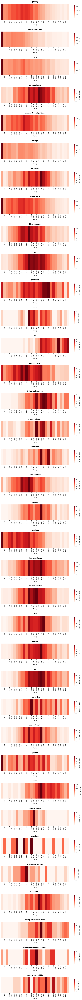

In [21]:
problems_rating_distribution = problems_rating_distribution.sort_index(axis=1)

n_rows = len(problems_rating_distribution)
n_cols = 1

fig, axes = plt.subplots(n_rows, n_cols, figsize=(10, 3*n_rows))
axes = axes.reshape(-1)

for i, (topic, row) in enumerate(problems_rating_distribution.iterrows()):
    ax = axes[i]
    topic_data = row.to_frame().T
    vmin = 0
    vmax = row.max()

    if vmax == 0:
        vmax = 1

    heatmap = sns.heatmap(
        data=topic_data,
        ax=ax,
        annot=False,
        fmt='d',
        cmap='Reds',
        cbar=True,
        cbar_kws={'shrink': 0.8, 'aspect': 10},
        vmin=vmin,
        vmax=vmax
    )

    cbar = heatmap.collections[0].colorbar
    cbar.ax.tick_params(labelsize=8)
    cbar.set_label('Number of tasks', rotation=90, labelpad=15, fontsize=9)


    ax.set_title(topic, fontsize=12, pad=12, fontweight='bold')
    ax.set_xlabel('Rating', fontsize=10, labelpad=8)
    ax.set_ylabel('')
    ax.tick_params(axis='x', labelsize=8)
    ax.tick_params(axis='y', left=False, labelleft=False)

plt.tight_layout(pad=2.5)
plt.show()

---
**Topics Solvability**

In this section, simple heatmap shows the solvability of each topic. Solvability for each problem is defined as:
$$solvability={{number\_of\_success\_trials}\over{number\_of\_trials}}$$
The trials are counted only during the contest.

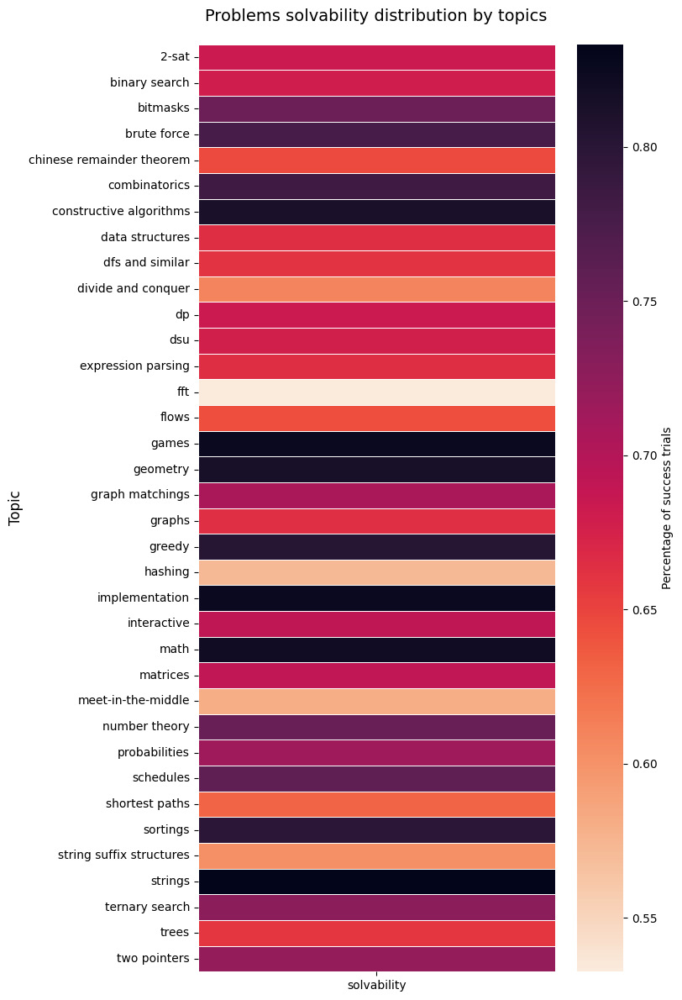

In [22]:
generalized_problems['trials'] = generalized_problems['success_trials'] + generalized_problems['unsuccess_trials']

tags_solvability = generalized_problems[['tag', 'success_trials', 'trials']].groupby(['tag']).sum()
tags_solvability['solvability'] = tags_solvability['success_trials'] / tags_solvability['trials']
tags_solvability = tags_solvability.drop(['success_trials', 'trials'], axis=1)

plt.figure(figsize=(8, 12))
ax = sns.heatmap(
    tags_solvability,
    cmap='rocket_r',
    annot=False,
    fmt='d',
    linewidths=.5,
    cbar_kws={'label': 'Percentage of success trials', 'shrink': 1}
)

plt.title('Problems solvability distribution by topics', fontsize=14, pad=20)
plt.ylabel('Topic', fontsize=12)

plt.tight_layout()
plt.show()

### User Performance Analysis

In this section, the dependencies between user rating and such parameters of a user, as number of solved tasks, difficulties of solved tasks, and time of registration on the platform are explored. 

---
**User data overview**

- Participants: the participants in contest with id=2061 are stored in file 'participations2061.json' and will be analyzed;
- Users: the information about each participants are stored in file 'users2061.json';
- Solutions: all the solutions of each user are parsed and stored in file 'solutions.json';

In [10]:
participations = pd.read_json('participations2061.json')
print(participations.head(), end='\n\n')
print(participations.info())

  user_handle  contest_id  rank  new_rating  rating_change
0     jiangly        2061     1        4039             63
1     tourist        2061     2        3841             26
2    gamegame        2061     3        3477            103
3        Benq        2061     4        3535             53
4   ecnerwala        2061     5        3542             28

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12647 entries, 0 to 12646
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   user_handle    12647 non-null  object
 1   contest_id     12647 non-null  int64 
 2   rank           12647 non-null  int64 
 3   new_rating     12647 non-null  int64 
 4   rating_change  12647 non-null  int64 
dtypes: int64(4), object(1)
memory usage: 494.2+ KB
None


In [11]:
users = pd.read_json('users2061.json')
print(users.head(), end='\n\n')
print(users.info())

      handle  registrationTimeSeconds
0    jiangly               1547985852
1    tourist               1265987288
2   gamegame               1446560101
3       Benq               1435099979
4  ecnerwala               1340834919

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12647 entries, 0 to 12646
Data columns (total 2 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   handle                   12647 non-null  object
 1   registrationTimeSeconds  12647 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 197.7+ KB
None


In [12]:
solutions = pd.read_json('solutions.json')
print(solutions.head(), end='\n\n')
print(solutions.info())

  user_handle  problem_contest_id problem_index  timeSeconds
0     jiangly                1105             A   1547986561
1     jiangly                1105             B   1547987132
2     jiangly                1105             C   1547987817
3     jiangly                1105             D   1547989175
4     jiangly                 454             A   1551429412

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3878831 entries, 0 to 3878830
Data columns (total 4 columns):
 #   Column              Dtype 
---  ------              ----- 
 0   user_handle         object
 1   problem_contest_id  int64 
 2   problem_index       object
 3   timeSeconds         int64 
dtypes: int64(2), object(2)
memory usage: 118.4+ MB
None


📌 Notice that users that have change of the rating > 200 are excluded from the analysis. This condition is developed to not consider users that are in stage of *'stabilization own level'*. It can take several rounds on Codeforces to found out own true range of rating.

📌 It is assumed, that users can have great experience in sport programmin until they start participation in codeforces rounds. 

In [26]:
participants = participations[participations['rating_change'] <= 200]

participants = users.merge(
    participants,
    left_on='handle',
    right_on='user_handle',
    how='inner'
).drop(['user_handle', 'rating_change', 'rank', 'contest_id'], axis=1).merge(
    pd.DataFrame(solutions['user_handle'].unique(), columns=['user_handle']),
    left_on='handle',
    right_on='user_handle',
    how='inner'
).drop(['user_handle'], axis=1)

participants = participants.rename(columns={'new_rating': 'rating'})

solutions_by_users = solutions.groupby(['user_handle']).count()['problem_contest_id']
participants['number_of_solved_problems'] = np.array(solutions_by_users.loc[participants['handle']])

---
**Correlation between user rating and number of solved problems**

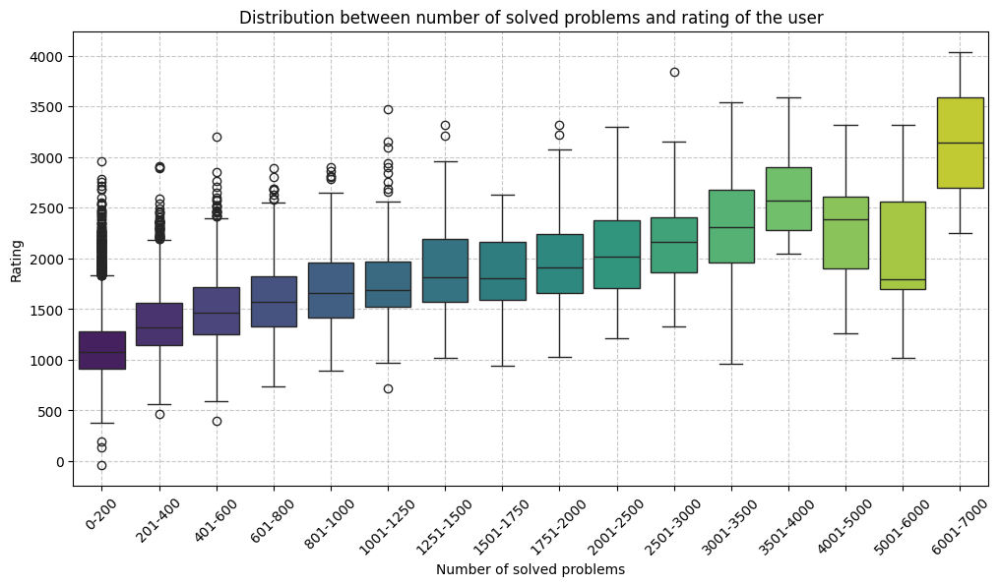

In [27]:
df = pd.DataFrame(participants)

bins = [0, 200, 400, 600, 800, 1000, 1250, 1500, 1750, 2000, 2500, 3000, 3500, 4000, 5000, 6000, 7000]
labels = ['0-200', '201-400', '401-600', '601-800', '801-1000',
          '1001-1250', '1251-1500', '1501-1750', '1751-2000', '2001-2500', '2501-3000', '3001-3500', '3501-4000', '4001-5000', '5001-6000', '6001-7000']
df['solved_group'] = pd.cut(df['number_of_solved_problems'], bins=bins, labels=labels)

plt.figure(figsize=(12, 6))
sns.boxplot(
    x='solved_group',
    y='rating',
    data=df,
    palette='viridis'
)

plt.title('Distribution between number of solved problems and rating of the user')
plt.xlabel('Number of solved problems')
plt.ylabel('Rating')
plt.xticks(rotation=45)
plt.grid(True, linestyle='--', alpha=0.7)

plt.show()

---
**Correlation between user rating and rating of the solved by user problems**

In [28]:
problems = pd.read_json("problems.json")

rated_solutions = solutions.merge(
    problems,
    left_on=['problem_contest_id', 'problem_index'],
    right_on=['contest_id', 'index'],
    how='inner'
).rename(columns={'rating': 'problem_rating'}).merge(
    participations,
    left_on='user_handle',
    right_on='user_handle',
    how='inner'
).rename(columns={'new_rating': 'user_rating'})

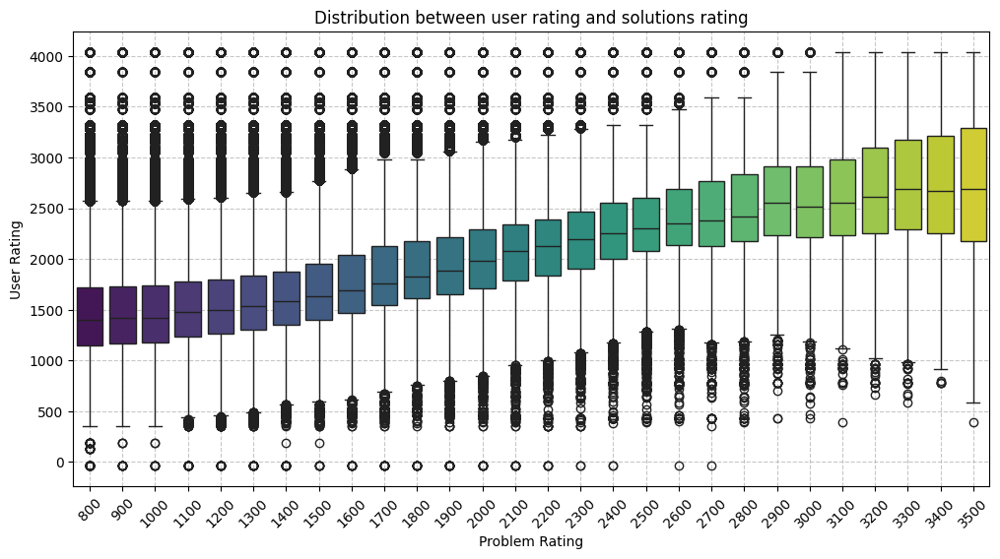

In [29]:
plt.figure(figsize=(12, 6))
sns.boxplot(
    x='problem_rating',
    y='user_rating',
    data=rated_solutions,
    palette='viridis'
)

plt.title('Distribution between user rating and solutions rating')
plt.xlabel('Problem Rating')
plt.ylabel('User Rating')
plt.xticks(rotation=45)
plt.grid(True, linestyle='--', alpha=0.7)

plt.show()

---
**Correlation between user rating and time of the registration on the platform (~ experience)**

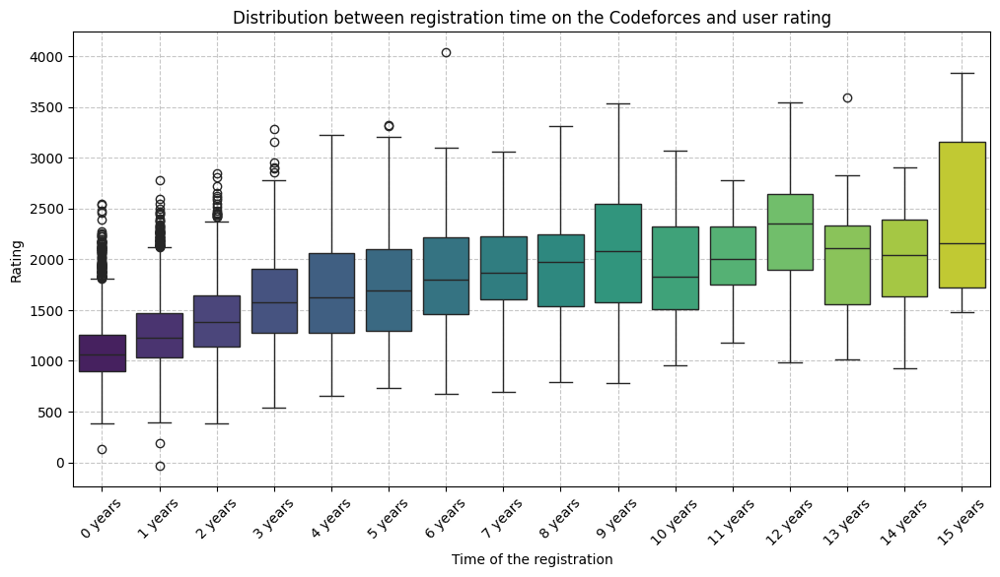

In [30]:
df = pd.DataFrame(participants)

bins = np.arange(0, 17, 1, 'int64')
labels = [f'{i} years' for i in range(16)]
df['solved_group'] = pd.cut((time.time() - df['registrationTimeSeconds']) / (3600 * 24 * 365), bins=bins, labels=labels)

plt.figure(figsize=(12, 6))
sns.boxplot(
    x='solved_group',
    y='rating',
    data=df,
    palette='viridis'
)

plt.title('Distribution between registration time on the Codeforces and user rating')
plt.xlabel('Time of the registration')
plt.ylabel('Rating')
plt.xticks(rotation=45)
plt.grid(True, linestyle='--', alpha=0.7)

plt.show()

### Blogs Analysis

The blogs analysis is performed via BERTopic model. The visualized result shows the most frequent topics, and their intercorrelation.

In [31]:
blogs = []
with open('blogs.json', "r", encoding='utf-8') as file:
    blogs = json.load(file)
texts = [blog['title'] for blog in blogs]

📌The BERT model is trained on 30000 blogs, the training can take from 5 up to 10 minutes

In [38]:
representation_model = KeyBERTInspired()
topic_model = BERTopic(representation_model=representation_model, language='multilingual')

topics, probs = topic_model.fit_transform(texts[:30000])

In [43]:
topic_model.visualize_topics()

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'customdata': array([[0, 'contests | contest | competitions | competition | contestants',
                                    434],
                                   [1, 'week | semana | weeks | dijous | days', 363],
                                   [2, '1343c | 1351c | 1345c | 1287b | 1288c', 270],
                                   ...,
                                   [605, 'gym | contest | xuzhou | mudanjiang | 2019', 11],
                                   [606, 'gcd | subsets | numbers | integers | max', 10],
                                   [607, 'queueforces | codeforces | queue | submission | quot', 10]],
                                  dtype=object),
              'hovertemplate': '<b>Topic %{customdata[0]}</b><br>%{customdata[1]}<br>Size: %{customdata[2]}',
              'legendgroup': '',
              'marker': {'color': '#B0BEC5',
                         'line': {'color': 'DarkSlateGrey', 'width': 2},
                         'size': {'bdata': ('sgFrAQ4B4gC/AKwAqQCjAJUAkgCOAI' ... 'ALAAsACwALAAsACwALAAsACgAKAA=='),
                                  'dtype': 'i2'},
                         'sizemode': 'area',
                         'sizeref': 0.27125,
                         'symbol': 'circle'},
              'mode': 'markers',
              'name': '',
              'orientation': 'v',
              'showlegend': False,
              'type': 'scatter',
              'x': {'bdata': ('Xn88QdglEkHL6+BAhPKUwBwIFz/jR0' ... 'xBwPCQwN1/PUEyHIRASJSfvvUBnUA='),
                    'dtype': 'f4'},
              'xaxis': 'x',
              'y': {'bdata': ('1L8UvAQJVz9nDHxBrHQowOPiM0Hq27' ... 'lBkDsNwMbhj0BAG5W/BP43QcZQTUE='),
                    'dtype': 'f4'},
              'yaxis': 'y'}],
    'layout': {'annotations': [{'showarrow': False,
                                'text': 'D1',
                                'x': np.float32(-14.480448),
                                'y': np.float32(4.732933),
                                'yshift': 10},
                               {'showarrow': False,
                                'text': 'D2',
                                'x': np.float32(4.834571),
                                'xshift': 10,
                                'y': np.float32(24.017101)}],
               'height': 650,
               'hoverlabel': {'bgcolor': 'white', 'font': {'family': 'Rockwell', 'size': 16}},
               'legend': {'itemsizing': 'constant', 'tracegroupgap': 0},
               'margin': {'t': 60},
               'shapes': [{'line': {'color': '#CFD8DC', 'width': 2},
                           'type': 'line',
                           'x0': np.float32(4.834571),
                           'x1': np.float32(4.834571),
                           'y0': np.float32(-14.551235),
                           'y1': np.float32(24.017101)},
                          {'line': {'color': '#9E9E9E', 'width': 2},
                           'type': 'line',
                           'x0': np.float32(-14.480448),
                           'x1': np.float32(24.14959),
                           'y0': np.float32(4.732933),
                           'y1': np.float32(4.732933)}],
               'sliders': [{'active': 0,
                            'pad': {'t': 50},
                            'steps': [{'args': [{'marker.color': [['red',
                                                                  '#B0BEC5',
                                                                  '#B0BEC5',
                                                                  '#B0BEC5',
                                                                  '#B0BEC5',
                                                                  '#B0BEC5',
                                                                  '#B0BEC5',
                                                                  '#B0BEC5',
                                                                  '#B0BEC5',
                            